# Vision Health Data Science Assignment

The input is a wav file that contains rooster crows and varying background noise. The task is the find the crow duration of each rooster. For validation purposes, before starting with the analysis, I have examined the data and manually measured the crow lengthts. While this measurement is rather noisy due to errors in my measurement, it is still better than having no baseline.

In [1]:
# The baseline_human dictionary provides rooster names as keys as integers by the order of appearence in the audio.
# The values of each key is a list containing the approximate starting point of the crow in string representation
# and the second element represents the measured crow lengths in milliseconds
baseline_human = {1: ['00:05', 2123], 2: ['00:08', 2376], 3: ['00:13', 1646], 4: ['00:17', 1274],
                  5: ['00:20', 2607], 6: ['00:23', 2896], 7: ['00:29', 2488], 8: ['00:33' , 2953],
                  9: ['00:40', 2456], 10: ['00:44', 2210], 11: ['00:48', 1953], 12: ['00:53', 2642],
                  13: ['00:58', 2024], 14: ['01:03', 2874], 15: ['01:08', 2796], 16: ['01:12', 2415],
                  17: ['01:17', 2291], 18: ['01:20', 2379], 19: ['01:25', 2620], 20: ['01:28', 2666],
                  21: ['01:32', 1332], 22: ['01:36', 2228], 23: ['01:41', 2159], 24: ['01:45', 1186],
                  25: ['01:48', 2456], 26: ['01:54', 2167], 27: ['01:59', 4457], 28: ['02:06', 1897],
                  29: ['02:17', 2054], 30: ['02:21', 2089], 31: ['02:29', 2937]}

## Import used libraries

In [2]:
import scipy.io.wavfile
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import librosa
import soundfile as sf
import noisereduce as nr 
import IPython.display as ipd

from scipy.fftpack import fft
from librosa import display

plt.rcParams['agg.path.chunksize'] = 10000

C:\Users\Burak\Anaconda3\lib\site-packages\noisereduce\noisereduce.py:5: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


## Take a look at the provided data file

In [3]:
data, sample_rate = librosa.load('rooster_competition.wav', sr=None, mono=False, offset=0.0, duration=None)

print("Shape of data: {}".format(data.shape))
print("The video has a sampling rate of: {}".format(sample_rate))
print("The audio file is {} seconds long".format(data.shape[1]/sample_rate))

# Since the audio file has 2 channels and it is not very easy to work with dual channel,
# we can merge the channels into mono by taking the mean.
data = np.mean(data, axis=0)

print("Shape of data after merging the channels: {}".format(data.shape))

Shape of data: (2, 7302583)
The video has a sampling rate of: 48000
The audio file is 152.13714583333334 seconds long
Shape of data after merging the channels: (7302583,)


## Initial plots to get a better understanding

First we can start by plotting the data. The sampled data provides us with amplitudes over time. These amplitudes describe the strenght/pressure of the sound wave.

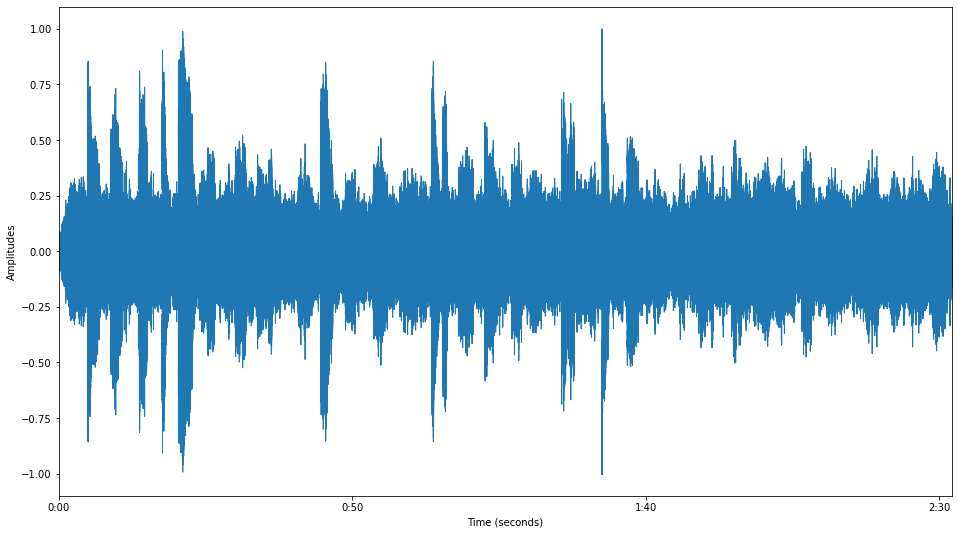

In [4]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=data, sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

We can also plot Short-time Fourier transformations of the data to get a better grasp at the frequencies used for a given window in time. We can observe that most of the activity is below the 5000 Hz range. Since the background noise contains a lot of speech and speech of humans are usually between 20-1000 Hz, I'm afraid this activity might be mostly noise.

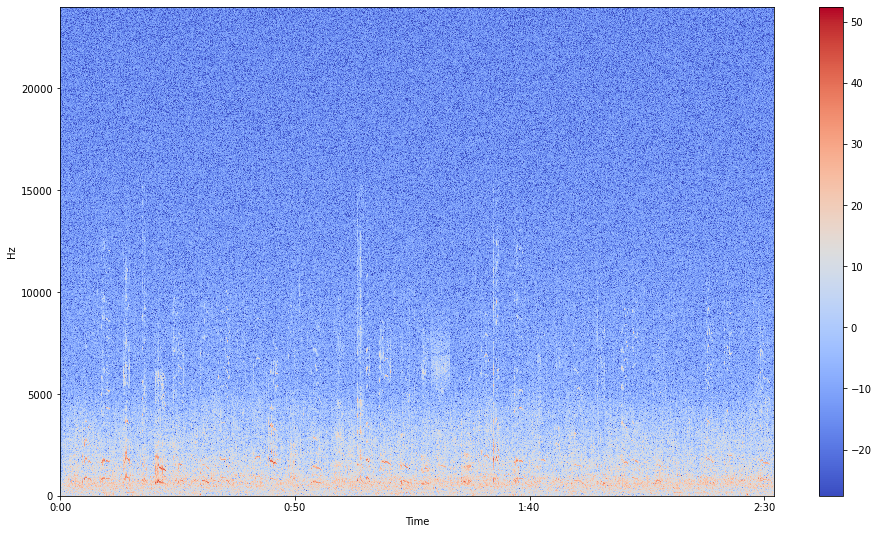

In [5]:
spec_data = librosa.stft(data)
spec_data_db = librosa.amplitude_to_db(abs(spec_data))
plt.figure(figsize=(16, 9))
librosa.display.specshow(spec_data_db, sr=sample_rate, x_axis='time', y_axis='hz')
plt.colorbar()
plt.show()

## Lets examine some parts with and without crow

By manual inspection, we know there is no crow in the first four seconds and a crow starts at approximately five second mark and lasts for two seconds. Lets inspect both of these parts.

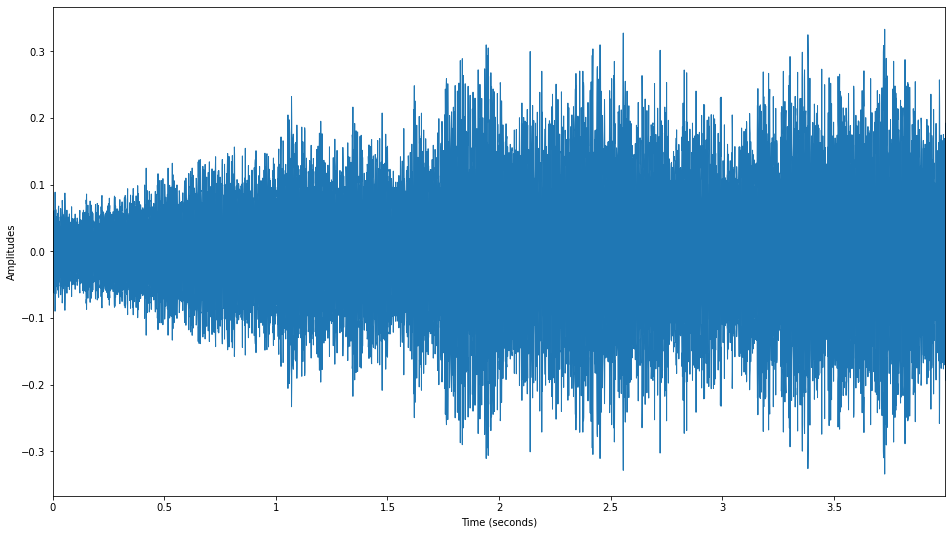

In [6]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=data[0:sample_rate*4], sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

We can listen to this part of the audio to see if it indeed does not contain any crow.

In [7]:
ipd.Audio(data[0:sample_rate*4], rate=sample_rate)

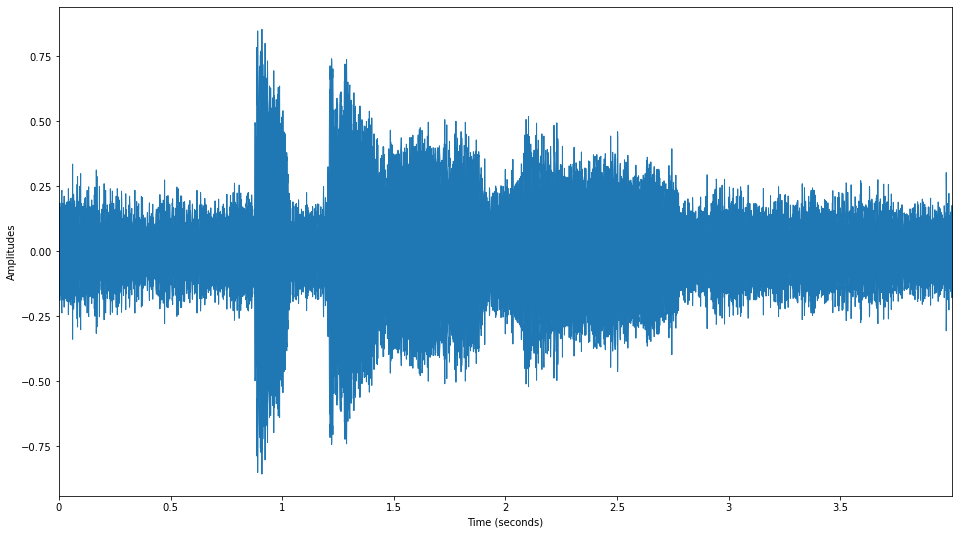

In [8]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=data[sample_rate*4:sample_rate*8], sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

In [9]:
ipd.Audio(data[sample_rate*4:sample_rate*8], rate=sample_rate)

In this example we can see that the crow has higher amplitudes throughout its duration. However is it always the case? In some cases the crow can be suppressed by the background noise, so it might not be as easy to hear or determine from the air pressure/ amplitudes. Lets check an example near the 79 second mark of the audio.

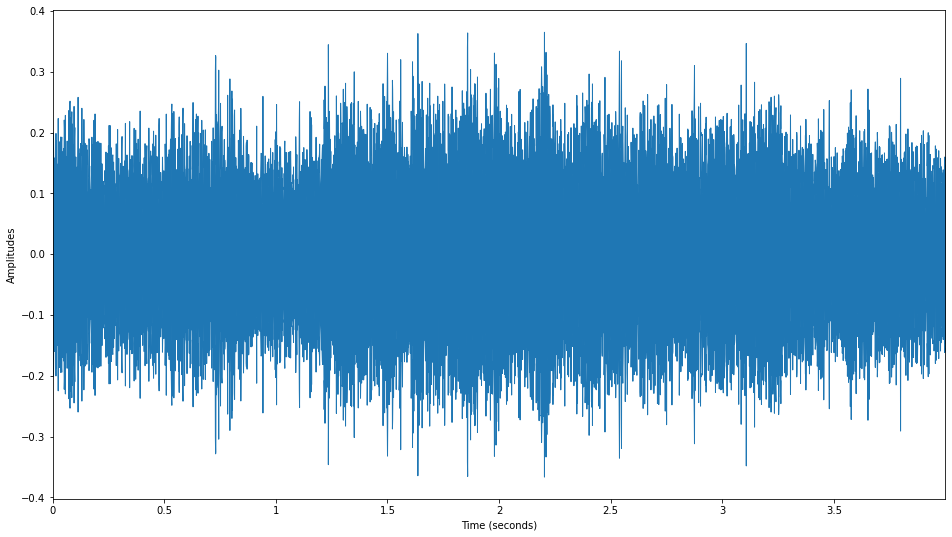

In [10]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=data[sample_rate*79:sample_rate*83], sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

If we listen carefully to this section, a crow is hardly noticable. Therefore, it is no surprise that the background noise has larger amplitudes.

In [11]:
ipd.Audio(data[sample_rate*79:sample_rate*83], rate=sample_rate)

The example clearly shows that amplitude information by itself is not enough to determine crow lengths. If we want to further investigate this route, we need a way to denoise the data. One way to achieve this is by using a representative noise file, finding out characteristics features of the noise and applying a filter on the main file based on these characteristics.

## Naive approach for denoising

First I have created a representative noise sample from the parts of the data that does not contain any crow.

In [12]:
noise = np.concatenate([data[:sample_rate*4], data[int(sample_rate*10.8):int(sample_rate*12.5)],
                        data[int(sample_rate*15):int(sample_rate*17)], data[int(sample_rate*79):int(sample_rate*80)],
                        data[int(sample_rate*83):int(sample_rate*85)], data[sample_rate*129:sample_rate*135]])

Then I have used this data with an existing noise reduction library in order to filter out the noise.

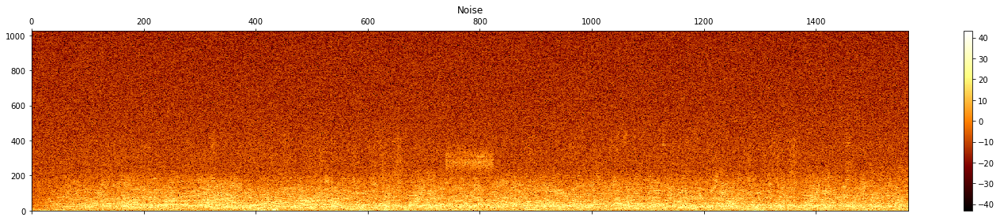

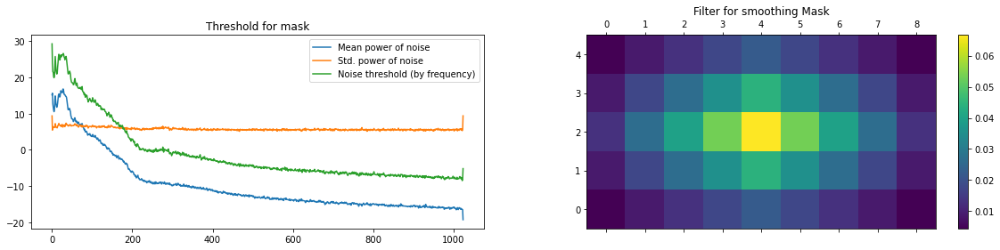

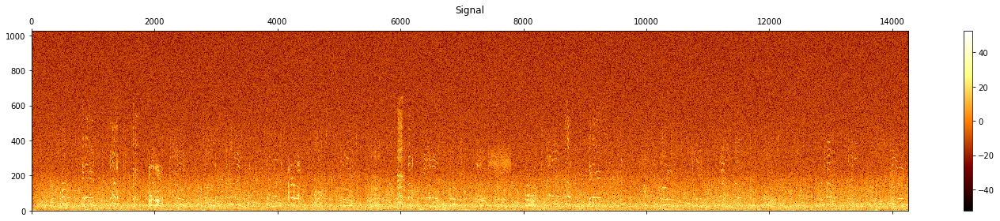

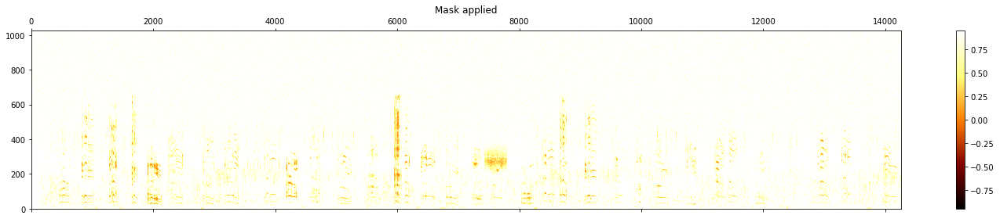

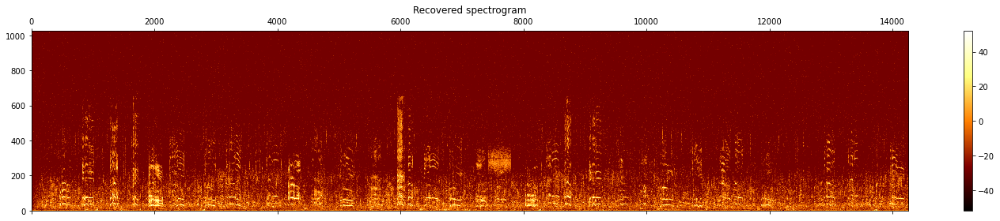

In [13]:
reduced_noise = nr.reduce_noise(audio_clip=data,noise_clip=noise, prop_decrease=0.95, verbose=True) 

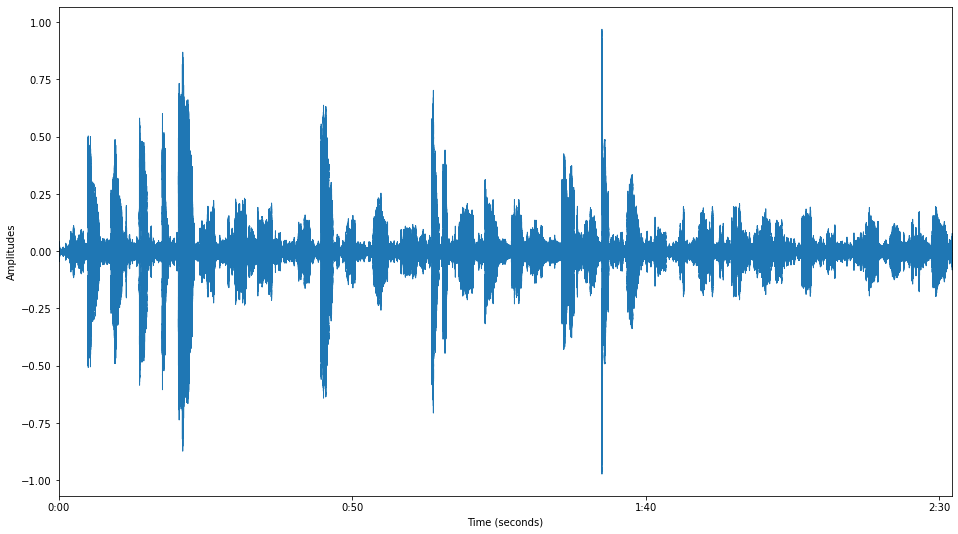

In [14]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=reduced_noise, sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

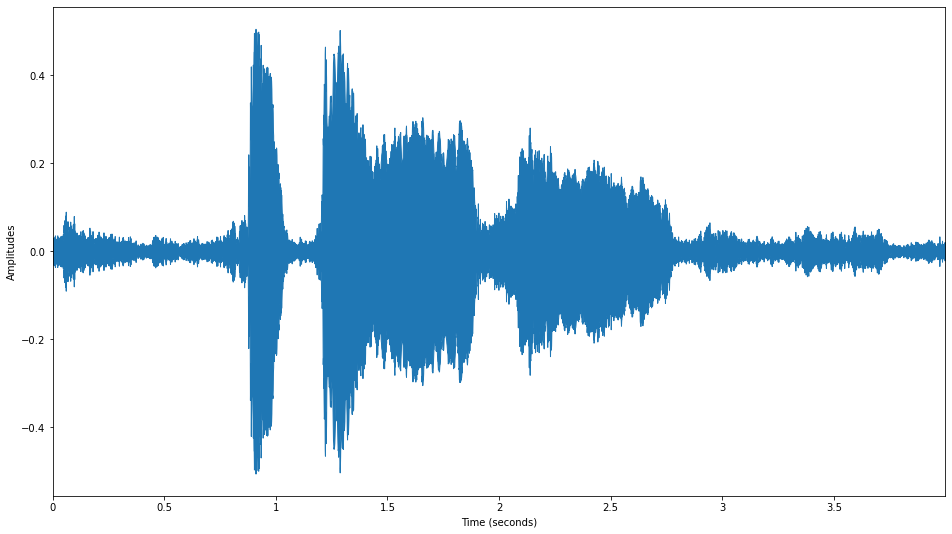

In [15]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=reduced_noise[sample_rate*4:sample_rate*8], sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

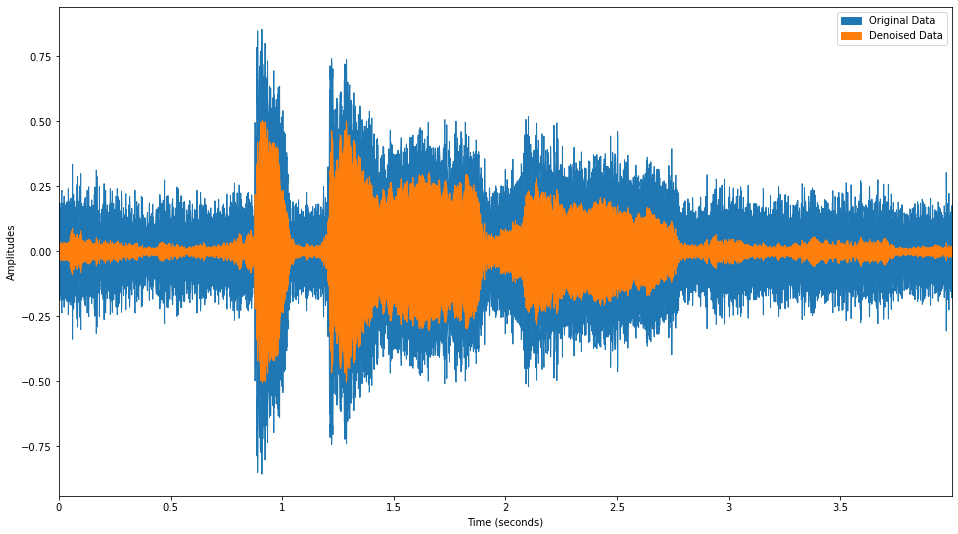

In [16]:
fig, ax = plt.subplots(figsize=(16,9))
librosa.display.waveplot(y=data[sample_rate*4:sample_rate*8], sr=sample_rate, label='Original Data')
librosa.display.waveplot(y=reduced_noise[sample_rate*4:sample_rate*8], sr=sample_rate, label='Denoised Data')
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
ax.legend(loc='upper right')
plt.show()

We can observe that denoising shrunk amplitudes of both background noise and the crow. However it made the crow part more apparent. Let us check the effects of denoising for the problematic part as well.

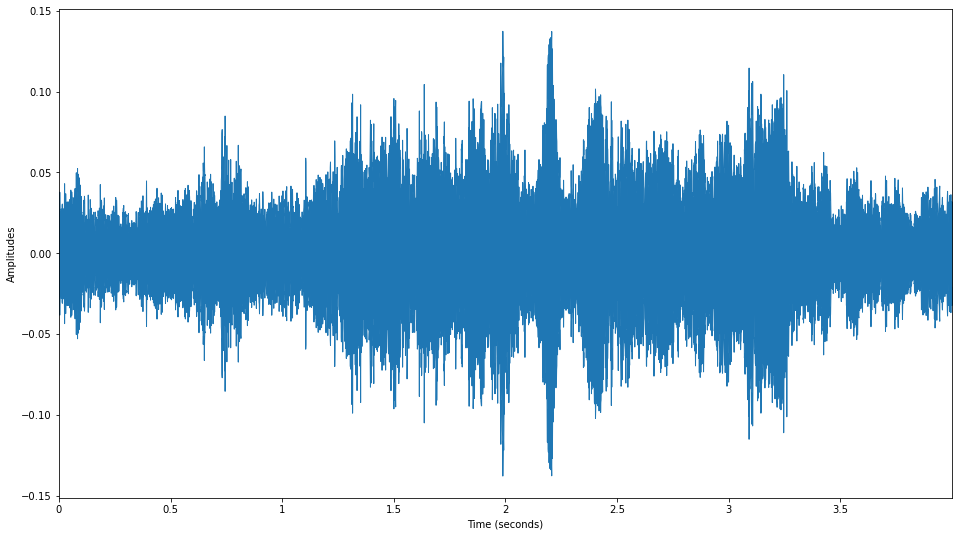

In [17]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=reduced_noise[sample_rate*79:sample_rate*83], sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

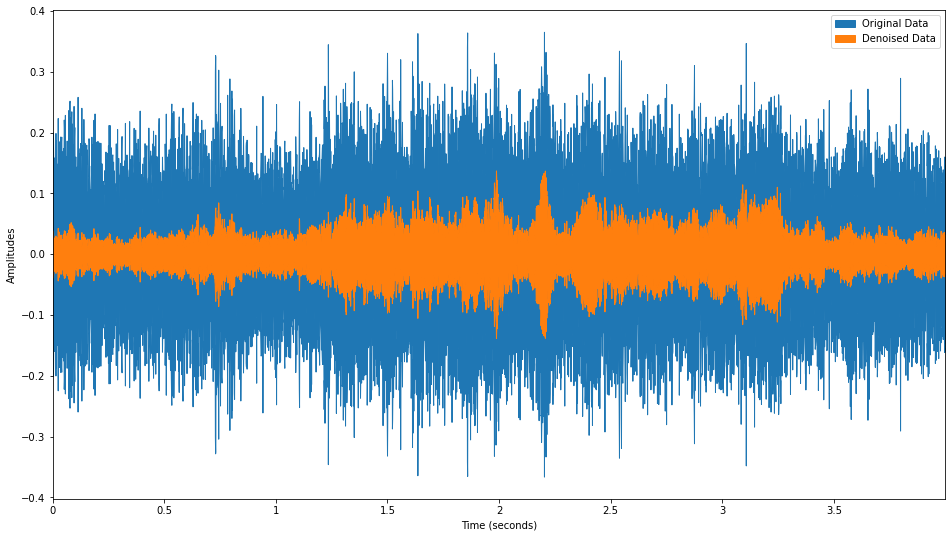

In [18]:
fig, ax = plt.subplots(figsize=(16,9))
librosa.display.waveplot(y=data[sample_rate*79:sample_rate*83], sr=sample_rate, label='Original Data')
librosa.display.waveplot(y=reduced_noise[sample_rate*79:sample_rate*83], sr=sample_rate, label='Denoised Data')
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
ax.legend(loc='upper right')
plt.show()

Unfortunately, even after denoising, this part still does not look very distinguishable. Next, I have tried some kind of window approach on the denoised data to approximate the crow lenghts. The idea was to detect the starting and end point of outliers, since the crow should in general be far away from the window mean.

In [19]:
start, stop = 4, 8
section_mean = np.mean(reduced_noise[sample_rate*start:sample_rate*stop])
section_var = np.var(reduced_noise[sample_rate*start:sample_rate*stop])
print("Section mean and variance: {}, {}".format(section_mean, section_var))
first, last = None, None
for idx, x in enumerate(reduced_noise[sample_rate*start:sample_rate*stop]):
    if abs(x) > section_mean + 16*section_var:
        last = idx
        if first is None:
            first = idx
if first is not None and last is not None:
    print("Section crow length: {}".format((last-first)/sample_rate))
else:
    print("Error")

Section mean and variance: -0.00020521628089714878, 0.005510762090681642
Section crow length: 2.6919791666666666


In [20]:
start, stop = 79, 83
section_mean = np.mean(reduced_noise[sample_rate*start:sample_rate*stop])
section_var = np.var(reduced_noise[sample_rate*start:sample_rate*stop])
print("Section mean and variance: {}, {}".format(section_mean, section_var))
first, last = None, None
for idx, x in enumerate(reduced_noise[sample_rate*start:sample_rate*stop]):
    if abs(x) > section_mean + 160*section_var:
        last = idx
        if first is None:
            first = idx
if first is not None and last is not None:
    print("Section crow length: {}".format((last-first)/sample_rate))
else:
    print("Error")

Section mean and variance: 0.0003579631168043131, 0.0005245664972635285
Section crow length: 2.516125


Unfortunately, variance coefficients to determine outliers vary greatly between different windows. Therefore I have given up on this approach. Next, I have tinkered with some window based extreame denoising (trying to set noisy parts to 0).

In [21]:
step = int(sample_rate)
threshold = 0.3
for idx in range(0, reduced_noise.shape[0], step):
    if reduced_noise[idx]:
        min_thres, max_thres = threshold*min(reduced_noise[idx:idx+step]), threshold*max(reduced_noise[idx:idx+step])
        reduced_noise[idx:idx+step][(reduced_noise[idx:idx+step] < max_thres) == (reduced_noise[idx:idx+step] > min_thres)] = 0

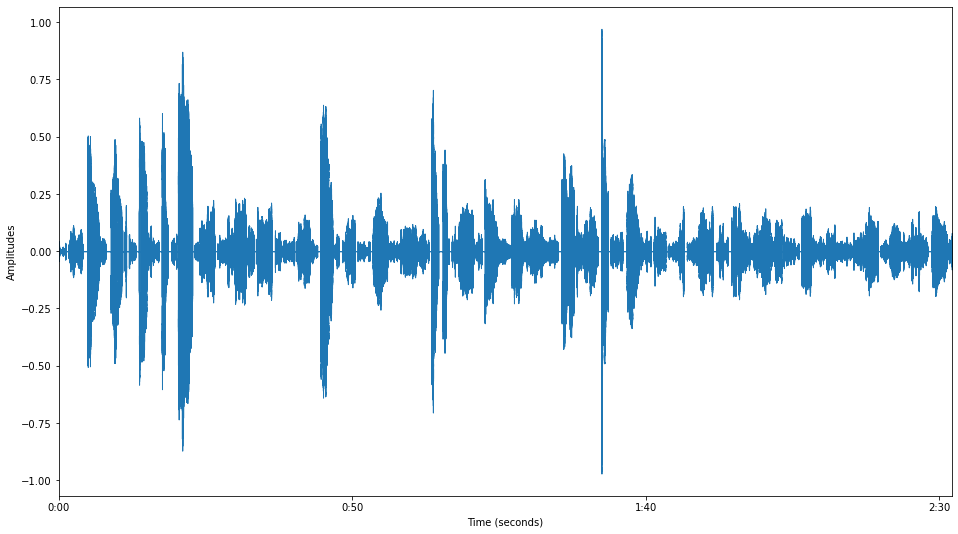

In [22]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(y=reduced_noise, sr=sample_rate)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitudes')
plt.show()

In [23]:
ipd.Audio(reduced_noise, rate=sample_rate)

Unfortunately this naive approach was also not successful.

# Next Steps: A more data scientific approach?

## Step 1: Data Collection
- Gather clean crow recordings
- Gather crow recordings with various natural background noise
- Create a noisy data set from clean recording by adding well well known possible noise types

## Step 2: Feature Extraction
- Extract crow spectral features by using all crow recordings with and without noise
- Features could be Spectral Centroid, Spectral Rolloff, Spectral Bandwidth, Zero-Crossing Rate, Mel-Frequency Cepstral Coefficients(MFCCs), Chroma Features

## Step 3: Dataset Creation
Now we have a labeled rooster crow data-set, we can create a bigger data-set with various sound files and their associated features which do not contain any rooster or crows.

## Step 4: Model Training
By using the labeled crow data-set, we can train a classification model that predicts if given features of an audio segment contains a rooster crow.

## Step 5: Model Evaluation
Let us assume we ended up with a model that can generalize well to the problem. Then we can feed spectral features belonging to the segments of an audio for classification. We can detect the crow length by using a sliding window and noting the start and end points of positive classification.

## Probably better approach: Transfer Learning
Instead of starting from stratch, one common approach is the use transfer learning by using a pretrained model as a baseline. In that case, we can use an already established model (like https://research.google.com/audioset/ ,  https://arxiv.org/pdf/1609.09430.pdf) as our starting point and modify the model according to our needs.